In [1]:
# Importing libraries
import pandas as pd
import numpy as np

# Visualisation
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# machine learning models
from sklearn.model_selection import train_test_split, learning_curve
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier, StackingClassifier, RandomForestClassifier
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# preprocessing
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline



In [2]:
data = pd.read_csv('data/conversion_data_train.csv')
data.shape

(284580, 6)

### 1. Data Exploration

In [3]:
df = data.copy()

In [4]:
df.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


In [5]:
print("Key statistics:")
print(df.describe(include='all'))
print()
print("Variables type : ")
print(df.dtypes)

Key statistics:
       country            age       new_user  source  total_pages_visited  \
count   284580  284580.000000  284580.000000  284580        284580.000000   
unique       4            NaN            NaN       3                  NaN   
top         US            NaN            NaN     Seo                  NaN   
freq    160124            NaN            NaN  139477                  NaN   
mean       NaN      30.564203       0.685452     NaN             4.873252   
std        NaN       8.266789       0.464336     NaN             3.341995   
min        NaN      17.000000       0.000000     NaN             1.000000   
25%        NaN      24.000000       0.000000     NaN             2.000000   
50%        NaN      30.000000       1.000000     NaN             4.000000   
75%        NaN      36.000000       1.000000     NaN             7.000000   
max        NaN     123.000000       1.000000     NaN            29.000000   

            converted  
count   284580.000000  
unique     

In [6]:
df.isna().sum()

country                0
age                    0
new_user               0
source                 0
total_pages_visited    0
converted              0
dtype: int64

Checking outliers

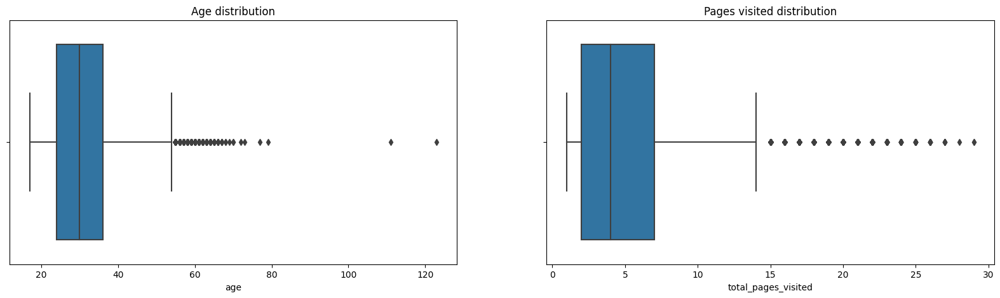

In [7]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 2, 1)
sns.boxplot(df, x='age')
plt.title('Age distribution')

plt.subplot(1, 2, 2)  # 1 ligne, 2 colonnes, sous-graphique 2
sns.boxplot(df, x='total_pages_visited')
plt.title('Pages visited distribution')

plt.show()

In [8]:
df.groupby(['converted'])['total_pages_visited'].value_counts()

converted  total_pages_visited
0          2                      39537
           3                      39454
           4                      36889
           1                      36637
           5                      32603
           6                      27104
           7                      20973
           8                      15527
           9                      10608
           10                      6870
           11                      4261
           12                      2441
           13                      1297
           14                       664
           15                       311
           16                       131
           17                        61
           18                        25
           19                         6
           20                         1
1          14                       947
           13                       894
           15                       885
           16                       866
         

In [9]:
Q1 = df['age'].quantile(0.25)
Q3 = df['age'].quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5*IQR
upper = Q3 + 1.5*IQR
    
#Filtrate the outliers
upper_rows = np.where(df['age']>=upper)[0]
lower_rows = np.where(df['age']<=lower)[0]

# Removing the outliers
df.drop(index=upper_rows, inplace=True)
df.drop(index=lower_rows, inplace=True)

### 2. Data Visualization

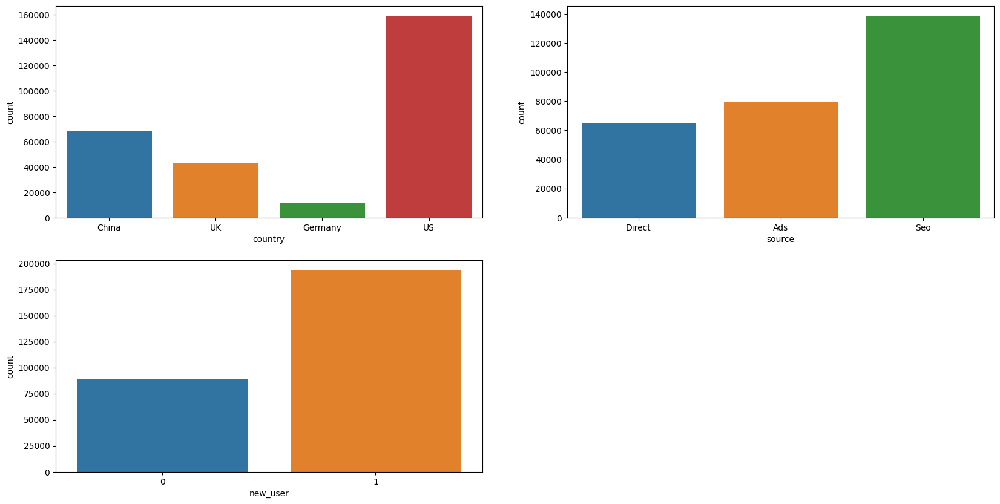

In [10]:
plt.figure(figsize=(20, 10))
plt.subplot(2, 2, 1)
sns.countplot(df, x='country')

plt.subplot(2, 2, 2)  # 1 ligne, 2 colonnes, sous-graphique 2
sns.countplot(df, x='source')

plt.subplot(2,2,3)
sns.countplot(df, x='new_user')

plt.show()

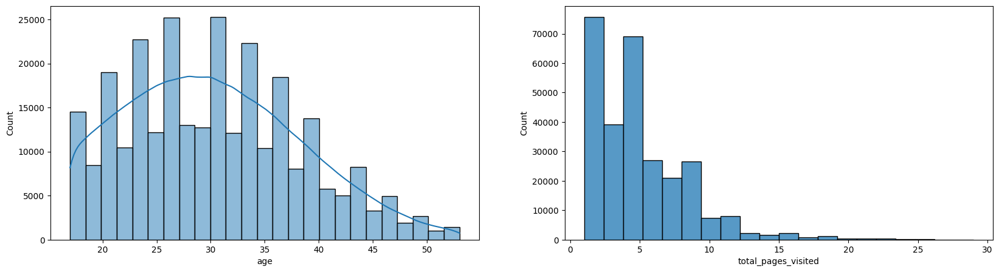

In [11]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 2, 1)
sns.histplot(df, x='age', bins=25, kde=True)

plt.subplot(1, 2, 2)
sns.histplot(df, x='total_pages_visited', bins=20)

plt.show()

In [12]:
import plotly.express as px

cols = ['age','total_pages_visited','source','new_user','country']
for col in cols:
    fig = px.histogram(df, x=df[col], facet_row='converted', color='converted', histnorm='probability')
    fig.show()

It seems that total pages visited is the most useful variable to determine a conversion or not.

In [13]:
df['converted'].value_counts()

converted
0    273583
1      9169
Name: count, dtype: int64

Really unbalanced datas, it will probably have a big impact on models

In [14]:
# Creating sample dataset because the dataset is too big
df_sampled = df.sample(50000)

In [15]:
# Creating a function to automate the testing of multiple models
def ml_model(model):
    
    #fit model to train set
    model.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    #apply model on test set
    y_pred = model.predict(X_test)
    print(f"Score on train set: {f1_score(y_train, y_train_pred)} | Score on test set: {f1_score(y_test, y_pred)}")
    print("\n")
    print(classification_report(y_test, y_pred))
    
    # set model learning curve parameters
    N, train_score, val_score = learning_curve(model, X_train, y_train, cv=5, scoring="f1", 
                                               train_sizes=np.linspace(0.1, 1, 10))
    
     # plot confusion matrix and learning curve
    fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=False, sharex=False)
    sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", ax=axes[0])
    axes[0].set_title("Confusion matrix")
    axes[1].plot(N, train_score.mean(axis=1))
    axes[1].plot(N, val_score.mean(axis=1))
    axes[1].set_title("Learning curve")
    axes[1].set_xlabel('train_sizes')
    axes[1].set_ylabel('scores')
    axes[1].set_ylim(0.65, 1.0)
    axes[1].legend(["train", "validation"])
    plt.show()

### 3. Data Preprocessing

In [16]:
# Separating target from features (baseline)
print('Separating target from the first feature : ')
target = 'converted'

X = df_sampled.drop(target, axis=1)
y = df_sampled.loc[:, target]

print('X:')
print(X.head())
print()
print('Y:')
print(y.head())

Separating target from the first feature : 
X:
        country  age  new_user  source  total_pages_visited
100680       US   37         1  Direct                   10
27100        US   34         1     Seo                    5
154927       US   39         0     Seo                    6
66661        US   27         1     Ads                    3
182069  Germany   36         1     Seo                    2

Y:
100680    0
27100     0
154927    0
66661     0
182069    0
Name: converted, dtype: int64


In [17]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



In [18]:
print("Encoding categorical features and standardizing numerical features...")

numeric_features = [1,4]
categorical_features = [0,2,3]

numeric_transformer = RobustScaler()
categorical_transformer = OneHotEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

X_train = preprocessor.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])
X_test = preprocessor.transform(X_test)
print()
print('...Done')
print(X_test[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[ 0.91666667  0.8         0.          0.          0.          1.
   0.          1.          1.          0.          0.        ]
 [-0.58333333 -0.4         0.          0.          0.          1.
   0.          1.          0.          0.          1.        ]
 [ 1.75       -0.6         1.          0.          0.          0.
   1.          0.          0.          0.          1.        ]
 [-0.66666667  0.          0.          0.          0.          1.
   0.          1.          0.          0.          1.        ]
 [-0.91666667 -0.2         0.          0.          0.          1.
   1.          0.          0.          0.          1.        ]]

...Done
[[-0.91666667  0.6         1.          0.          0.          0.
   0.          1.          0.          0.          1.        ]
 [-0.16666667 -0.2         0.          0.          0.          1.
   0.          1.          0.          0.          1.        ]
 [ 1.4166

In [19]:
# Initialize processing and machine learning pipelines
logreg = make_pipeline(preprocessor, LogisticRegression(random_state=0, max_iter=1000))
knn = make_pipeline(preprocessor, KNeighborsClassifier())
tree = make_pipeline(preprocessor, DecisionTreeClassifier(random_state=0))
adaboost = make_pipeline(preprocessor, AdaBoostClassifier(random_state=0))
random_forest = make_pipeline(preprocessor, RandomForestClassifier(random_state=0))
gbc = make_pipeline(preprocessor, GradientBoostingClassifier(random_state=0))
xgboost = make_pipeline(preprocessor, XGBClassifier())

# Store pipelines in dict
model_dict = {
    "LogReg" : logreg,
    "KNN" : knn,
    "DecisionTree" : tree,
    "AdaBoost" : adaboost,
    "RandomForest" : random_forest,
    "GBC" : gbc,
    "XGB" : xgboost
}

### 4. Machine Learning

----------------------------------------------------------------
LogReg
Score on train set: 0.7242290748898678 | Score on test set: 0.7628524046434494


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.81      0.72      0.76       319

    accuracy                           0.99     10000
   macro avg       0.90      0.86      0.88     10000
weighted avg       0.99      0.99      0.99     10000



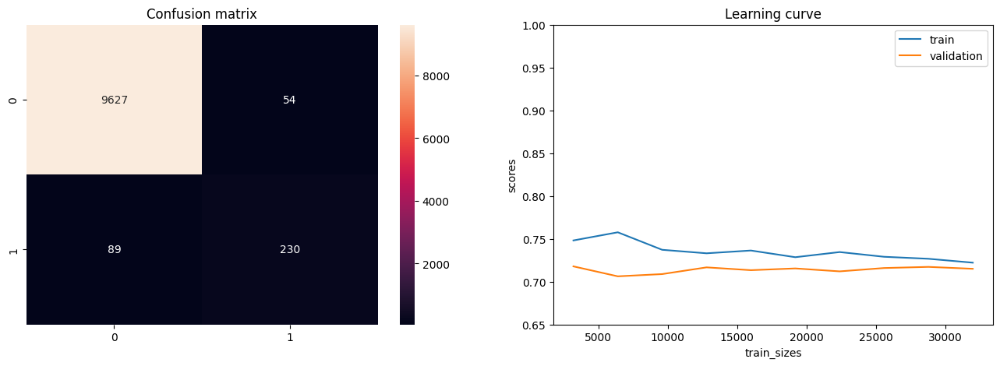

----------------------------------------------------------------
KNN
Score on train set: 0.7443448570209132 | Score on test set: 0.6991869918699186


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.73      0.67      0.70       319

    accuracy                           0.98     10000
   macro avg       0.86      0.83      0.84     10000
weighted avg       0.98      0.98      0.98     10000



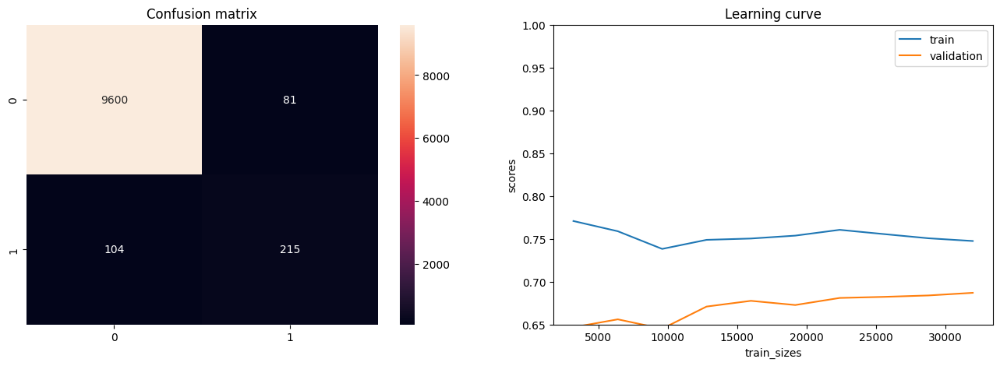

----------------------------------------------------------------
DecisionTree
Score on train set: 0.7630989699955217 | Score on test set: 0.7015177065767285


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.76      0.65      0.70       319

    accuracy                           0.98     10000
   macro avg       0.87      0.82      0.85     10000
weighted avg       0.98      0.98      0.98     10000



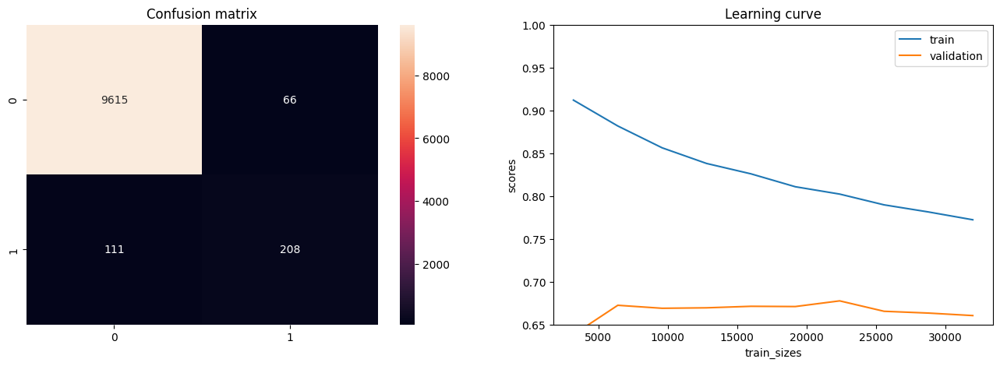

----------------------------------------------------------------
AdaBoost
Score on train set: 0.724762726488352 | Score on test set: 0.7623762376237623


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.80      0.72      0.76       319

    accuracy                           0.99     10000
   macro avg       0.90      0.86      0.88     10000
weighted avg       0.99      0.99      0.99     10000



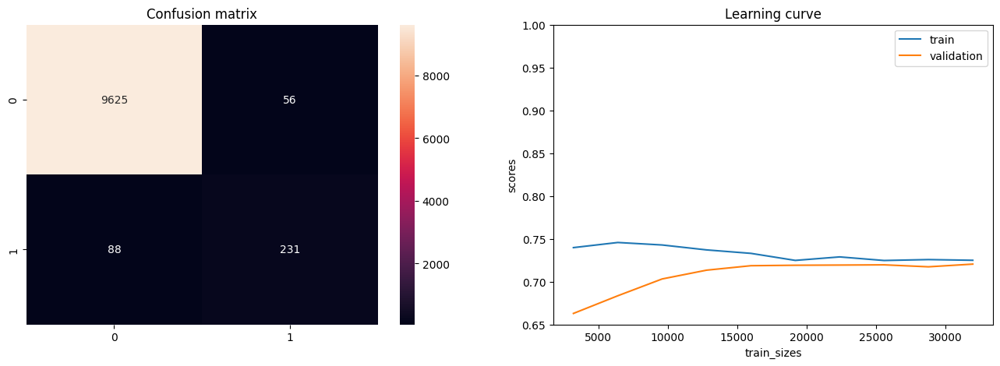

----------------------------------------------------------------
RandomForest
Score on train set: 0.7710947641713544 | Score on test set: 0.7039473684210527


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.74      0.67      0.70       319

    accuracy                           0.98     10000
   macro avg       0.86      0.83      0.85     10000
weighted avg       0.98      0.98      0.98     10000



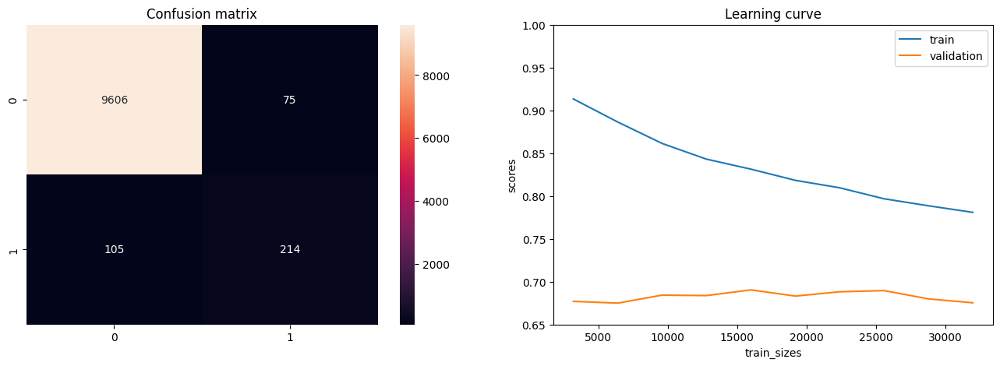

----------------------------------------------------------------
GBC
Score on train set: 0.7345207803223072 | Score on test set: 0.7622149837133553


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.79      0.73      0.76       319

    accuracy                           0.99     10000
   macro avg       0.89      0.86      0.88     10000
weighted avg       0.98      0.99      0.99     10000



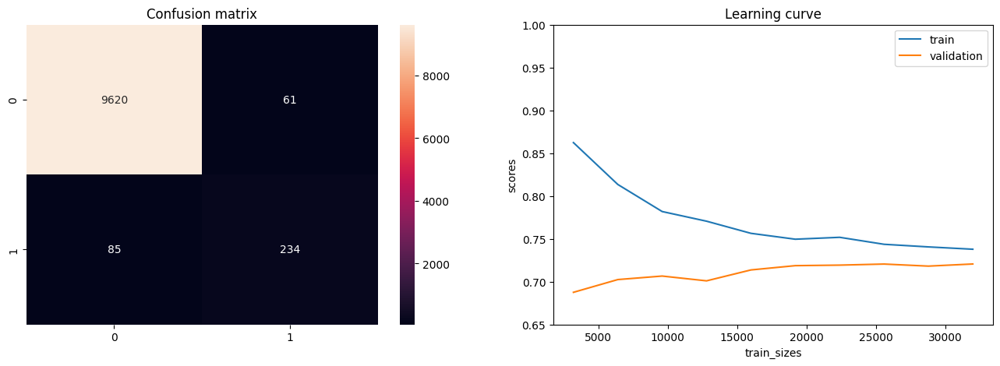

----------------------------------------------------------------
XGB
Score on train set: 0.746631899174272 | Score on test set: 0.7391304347826088


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.79      0.69      0.74       319

    accuracy                           0.98     10000
   macro avg       0.89      0.84      0.87     10000
weighted avg       0.98      0.98      0.98     10000



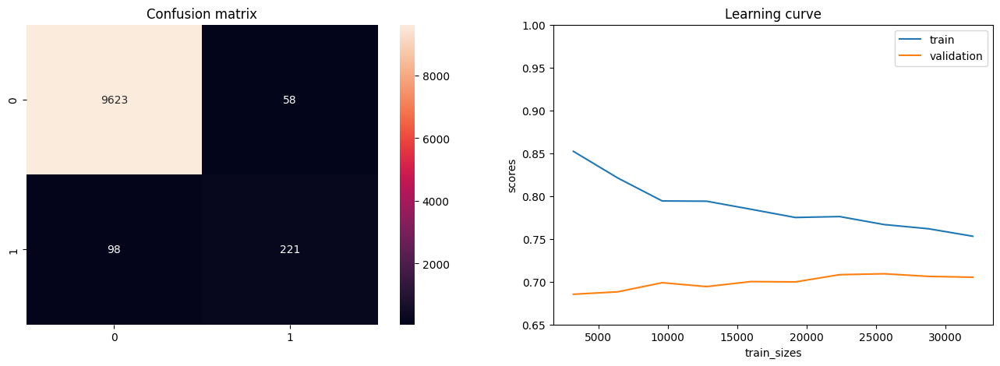

CPU times: user 14min 42s, sys: 1min 4s, total: 15min 46s
Wall time: 3min 19s


In [20]:
%%time
# Iterate over models (non-optimized)
for name, model in model_dict.items():
    print("----------------------------------------------------------------")
    print(name)
    ml_model(model)

Result :

. Logistic Regression 0.76

. KNN 0.69

. DecisionTree 0.70

. AdaBoost 0.76

. RandomForest 0.70

. GradientBoosting 0.76

. XGBoost 0.73


We have some models that are not bad like Adaboost and Logistic Regression but it will probably be better with some optimization. Let's try again the models with gridSearch.

In [21]:
# Same function as above but with gridSearch
def gridsearch(model, grid_model):
    
    #fit model to train set
    grid_model.fit(X_train, y_train)
    
    #apply model on test set
    y_pred = grid_model.predict(X_test)
    print(f"Best parameters :{grid_model.best_params_}")
    print(f"Score on train set: {grid_model.score(X_train, y_train)} | Score on test set: {grid_model.score(X_test, y_test)}")
    print("\n")
    print(classification_report(y_test, y_pred))
    
    # set model learning curve parameters
    N, train_score, val_score = learning_curve(grid_model.best_estimator_, X_train, y_train, cv=5, scoring="f1", 
                                               train_sizes=np.linspace(0.1, 1, 10))
    
     # plot confusion matrix and learning curve
    fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=False, sharex=False)
    sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", ax=axes[0])
    axes[0].set_title("Confusion matrix")
    axes[1].plot(N, train_score.mean(axis=1))
    axes[1].plot(N, val_score.mean(axis=1))
    axes[1].set_title("Learning curve")
    axes[1].set_xlabel('train_sizes')
    axes[1].set_ylabel('scores')
    axes[1].set_ylim(0.65, 1.0)
    axes[1].legend(["train", "validation"])
    plt.show()

In [22]:
# Initialize parameters to optimize ML models
params = {
    "LogReg" : {
        "logisticregression__C" : np.logspace(-3, 3, 20),
    },
    
    "KNN" : {
        "kneighborsclassifier__n_neighbors" : np.arange(1, 11),
        "kneighborsclassifier__metric": ['euclidean', 'manhattan', 'cosine'],
    },

    "DecisionTree" : {
        "decisiontreeclassifier__max_depth": [2, 10, 20],
        "decisiontreeclassifier__min_samples_leaf": [1,5,10,15],
        "decisiontreeclassifier__min_samples_split": [2, 5, 10, 15],
    },
    
    "AdaBoost" : {
        "adaboostclassifier__n_estimators" : np.arange(10, 200, 10),
        "adaboostclassifier__learning_rate" : [0.1, 0.5, 1]
    },
    
    "GBC" : {
        "gradientboostingclassifier__n_estimators" : np.arange(10, 100, 10),
        "gradientboostingclassifier__max_depth": np.arange(1, 10, 1),
        "gradientboostingclassifier__min_samples_leaf": np.arange(1,10,1)
    },
    
    "XGB" : {
        "xgbclassifier__max_depth": [4, 6, 8],
        "xgbclassifier__min_child_weight": [1, 2, 3, 4],
        "xgbclassifier__n_estimators": [25, 50, 100],
        "xgbclassifier__max_delta_step" : [0, 1, 3, 5]
    }
    
}

In [23]:
# Store optimized models in dictionary
grid_dict = {
    "LogReg" : GridSearchCV(logreg, params["LogReg"], cv=5, scoring='f1', n_jobs=-1),
    "KNN" : GridSearchCV(knn, params["KNN"], cv=5, scoring='f1', n_jobs=-1),
    "DecisionTree" : GridSearchCV(tree, params["DecisionTree"], cv=5, scoring='f1', n_jobs=-1),
    "AdaBoost" : GridSearchCV(adaboost, params["AdaBoost"], cv=5, scoring='f1', n_jobs=-1),
    "GBC" : GridSearchCV(gbc, params["GBC"], cv=5, scoring='f1', n_jobs=-1),
    "XGB" : GridSearchCV(xgboost, params["XGB"], cv=5, scoring='f1', n_jobs=-1)
}

----------------------------------------------------------------
LogReg


Best parameters :{'logisticregression__C': 0.3359818286283781}
Score on train set: 0.7216312056737589 | Score on test set: 0.76


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.81      0.71      0.76       319

    accuracy                           0.99     10000
   macro avg       0.90      0.85      0.88     10000
weighted avg       0.98      0.99      0.99     10000



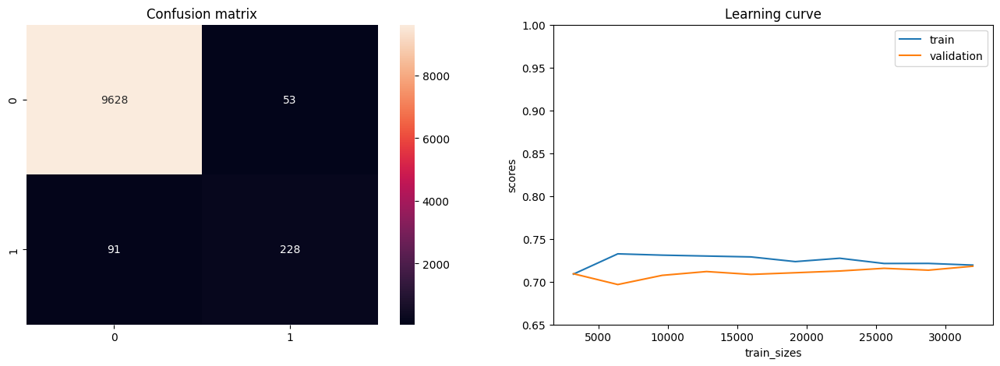

----------------------------------------------------------------
KNN
Best parameters :{'kneighborsclassifier__metric': 'euclidean', 'kneighborsclassifier__n_neighbors': 7}
Score on train set: 0.7424836601307191 | Score on test set: 0.7114093959731543


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.77      0.66      0.71       319

    accuracy                           0.98     10000
   macro avg       0.88      0.83      0.85     10000
weighted avg       0.98      0.98      0.98     10000



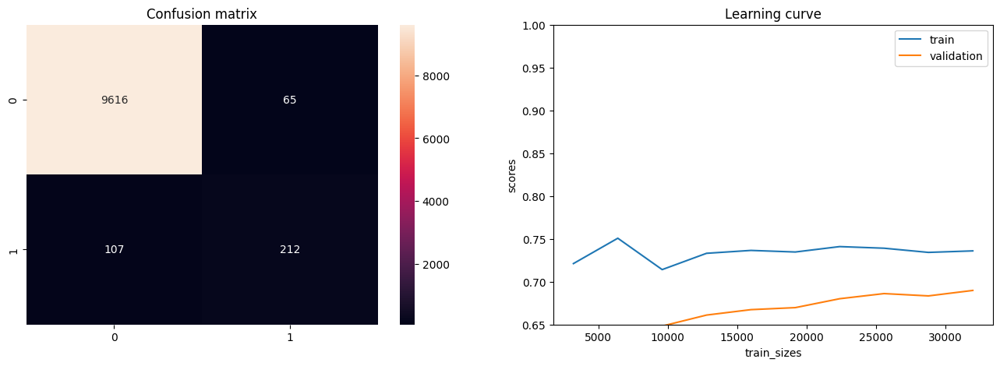

----------------------------------------------------------------
DecisionTree
Best parameters :{'decisiontreeclassifier__max_depth': 10, 'decisiontreeclassifier__min_samples_leaf': 5, 'decisiontreeclassifier__min_samples_split': 2}
Score on train set: 0.7453936348408712 | Score on test set: 0.7278582930756845


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.75      0.71      0.73       319

    accuracy                           0.98     10000
   macro avg       0.87      0.85      0.86     10000
weighted avg       0.98      0.98      0.98     10000



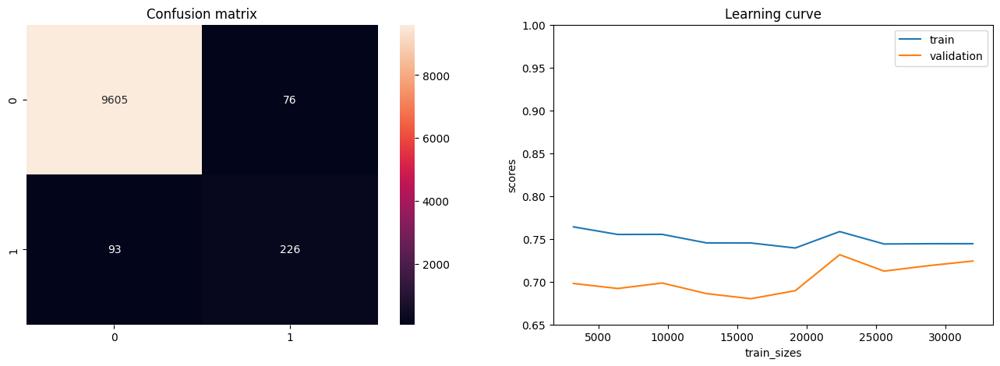

----------------------------------------------------------------
AdaBoost
Best parameters :{'adaboostclassifier__learning_rate': 0.5, 'adaboostclassifier__n_estimators': 30}
Score on train set: 0.7259756609315988 | Score on test set: 0.7568438003220611


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.78      0.74      0.76       319

    accuracy                           0.98     10000
   macro avg       0.88      0.86      0.87     10000
weighted avg       0.98      0.98      0.98     10000



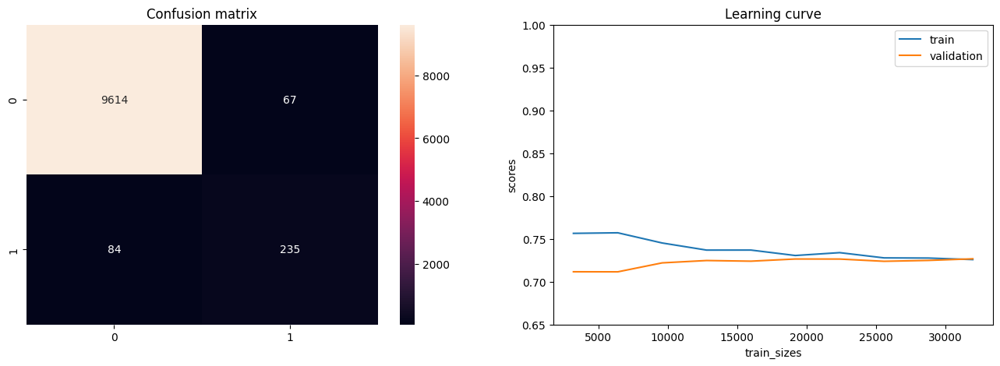

----------------------------------------------------------------
GBC
Best parameters :{'gradientboostingclassifier__max_depth': 2, 'gradientboostingclassifier__min_samples_leaf': 2, 'gradientboostingclassifier__n_estimators': 60}
Score on train set: 0.7275 | Score on test set: 0.759170653907496


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.77      0.75      0.76       319

    accuracy                           0.98     10000
   macro avg       0.88      0.87      0.88     10000
weighted avg       0.98      0.98      0.98     10000



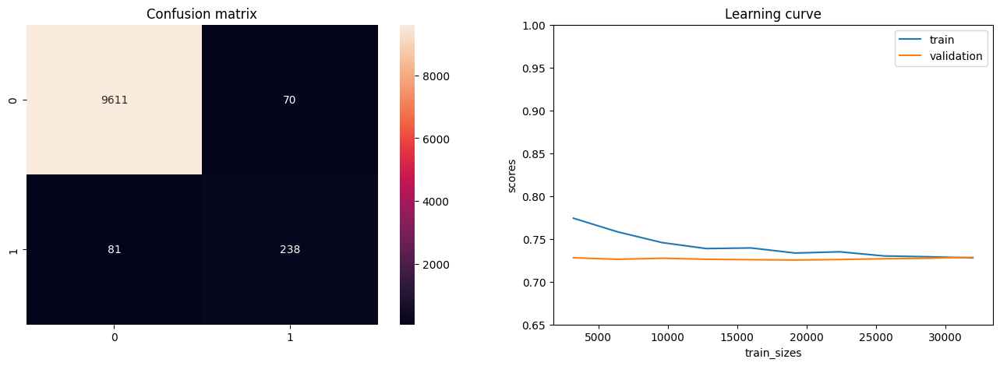

----------------------------------------------------------------
XGB
Best parameters :{'xgbclassifier__max_delta_step': 1, 'xgbclassifier__max_depth': 4, 'xgbclassifier__min_child_weight': 2, 'xgbclassifier__n_estimators': 25}
Score on train set: 0.7337025990626332 | Score on test set: 0.764516129032258


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9681
           1       0.79      0.74      0.76       319

    accuracy                           0.99     10000
   macro avg       0.89      0.87      0.88     10000
weighted avg       0.99      0.99      0.99     10000



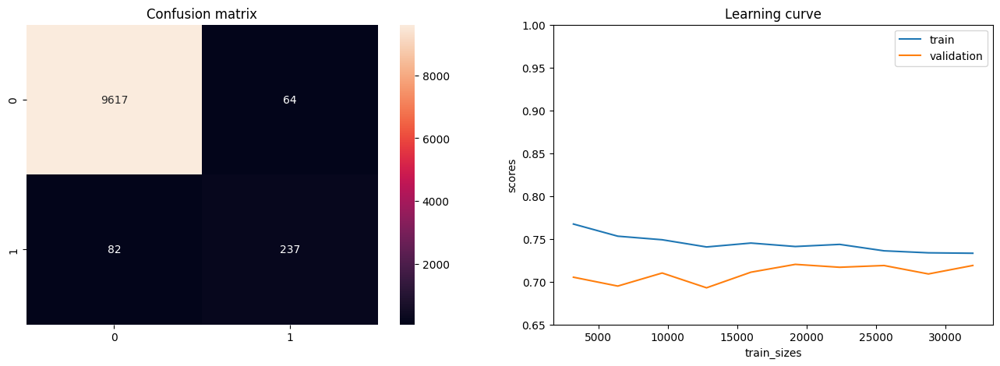

CPU times: user 12min 58s, sys: 54.1 s, total: 13min 52s
Wall time: 14min


In [24]:
%%time
for name, grid in grid_dict.items():
    print("----------------------------------------------------------------")
    print(name)
    gridsearch(name, grid)

Let's check the result : 

. Logistic Regression 0.76

. KNN 0.71

. DecisionTree 0.72

. AdaBoost 0.75

. GradientBoosting 0.75

. XGBoost 0.76

We can see little progress in KNN, DecisionTree and XGBoost models, for the others 3 it's globally the same. The models have no problem to predict "0" but it is more difficult with "1". For LogReg, XGB, GBC and AdaBoost we have 0.76 on f1-score for the "1" predictions which is not bad.

The learning curves don't seem to show any particular overfitting but it was sure the unbalanced data would be a problem.

I will try something to see if we can have better results.

### 5. Testing Polynomial Features

In [25]:
df_test = df_sampled.copy()

In [26]:
# Separating target from features (baseline)
print('Separating target from the first feature : ')
target = 'converted'

X = df_test.drop(target, axis=1)
y = df_test.loc[:, target]

print('X:')
print(X.head())
print()
print('Y:')
print(y.head())

Separating target from the first feature : 
X:
        country  age  new_user  source  total_pages_visited
100680       US   37         1  Direct                   10
27100        US   34         1     Seo                    5
154927       US   39         0     Seo                    6
66661        US   27         1     Ads                    3
182069  Germany   36         1     Seo                    2

Y:
100680    0
27100     0
154927    0
66661     0
182069    0
Name: converted, dtype: int64


In [27]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



In [28]:
from sklearn.preprocessing import PolynomialFeatures
print("Encoding categorical features and standardizing numerical features...")

numeric_features = [1,4]
categorical_features = [0,2,3]

numeric_transformer = Pipeline(steps=[
    ('scaler', RobustScaler()),
    ('poly', PolynomialFeatures(2))
])

categorical_transformer = OneHotEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

X_train = preprocessor.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])
X_test = preprocessor.transform(X_test)
print()
print('...Done')
print(X_test[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[ 1.          0.91666667  0.8         0.84027778  0.73333333  0.64
   0.          0.          0.          1.          0.          1.
   1.          0.          0.        ]
 [ 1.         -0.58333333 -0.4         0.34027778  0.23333333  0.16
   0.          0.          0.          1.          0.          1.
   0.          0.          1.        ]
 [ 1.          1.75       -0.6         3.0625     -1.05        0.36
   1.          0.          0.          0.          1.          0.
   0.          0.          1.        ]
 [ 1.         -0.66666667  0.          0.44444444 -0.          0.
   0.          0.          0.          1.          0.          1.
   0.          0.          1.        ]
 [ 1.         -0.91666667 -0.2         0.84027778  0.18333333  0.04
   0.          0.          0.          1.          1.          0.
   0.          0.          1.        ]]

...Done
[[ 1.         -0.91666667  0.6         0.84027778

1. Logistic Regression

Best parameters :{'C': 54.555947811685144}
Score on train set: 0.7599309153713298 | Score on test set: 0.7979966611018363


              precision    recall  f1-score   support

           0       0.99      1.00      0.99      9681
           1       0.85      0.75      0.80       319

    accuracy                           0.99     10000
   macro avg       0.92      0.87      0.90     10000
weighted avg       0.99      0.99      0.99     10000



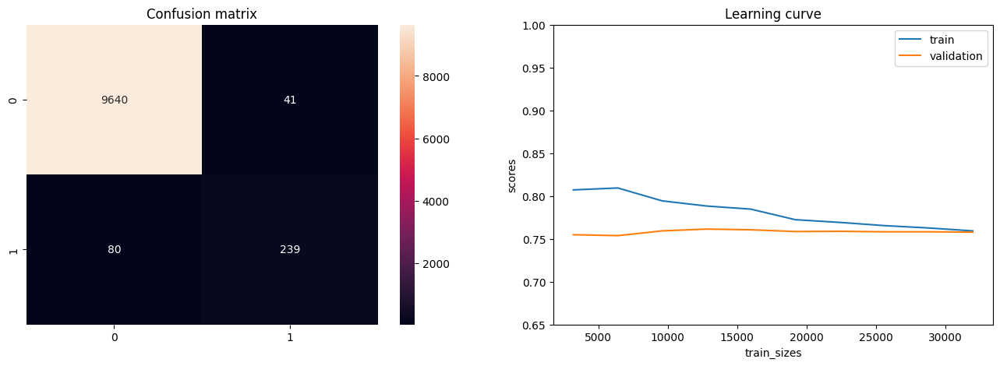

In [30]:
log_model = LogisticRegression(max_iter=500)

#fit model to train set
log_model.fit(X_train, y_train)

# Define hyperparameters
params = {
    "C" : np.logspace(-3, 3, 20),
}

# fit gridsearch
grid_log = GridSearchCV(log_model, params, cv=5, scoring='f1', n_jobs=-1)
grid_log.fit(X_train, y_train)

# apply on test set
y_pred = grid_log.predict(X_test)
print(f"Best parameters :{grid_log.best_params_}")
print(f"Score on train set: {grid_log.score(X_train, y_train)} | Score on test set: {grid_log.score(X_test, y_test)}")
print("\n")
print(classification_report(y_test, y_pred))
    
# set model learning curve parameters
N, train_score, val_score = learning_curve(grid_log.best_estimator_, X_train, y_train, cv=5, scoring="f1", 
                                            train_sizes=np.linspace(0.1, 1, 10))
    
    # plot confusion matrix and learning curve
fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=False, sharex=False)
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", ax=axes[0])
axes[0].set_title("Confusion matrix")
axes[1].plot(N, train_score.mean(axis=1))
axes[1].plot(N, val_score.mean(axis=1))
axes[1].set_title("Learning curve")
axes[1].set_xlabel('train_sizes')
axes[1].set_ylabel('scores')
axes[1].set_ylim(0.65, 1.0)
axes[1].legend(["train", "validation"])
plt.show()

Best parameters :{'learning_rate': 0.5, 'n_estimators': 80}
Score on train set: 0.75619295958279 | Score on test set: 0.783050847457627


              precision    recall  f1-score   support

           0       0.99      1.00      0.99      9681
           1       0.85      0.72      0.78       319

    accuracy                           0.99     10000
   macro avg       0.92      0.86      0.89     10000
weighted avg       0.99      0.99      0.99     10000



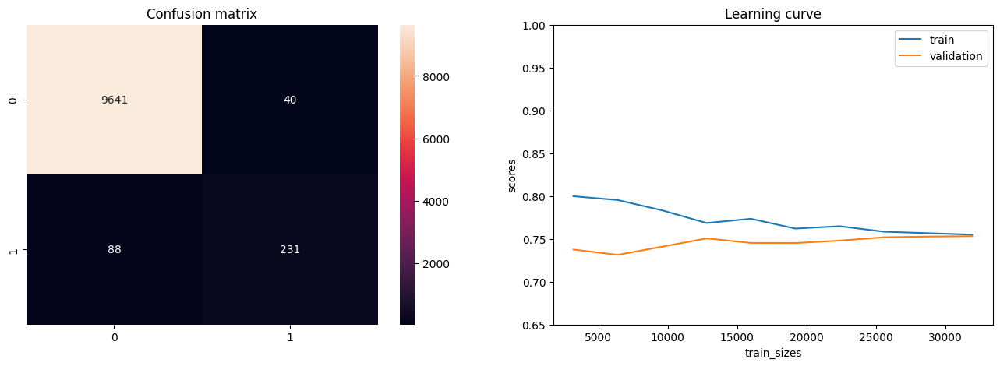

In [31]:
ada_model = AdaBoostClassifier(random_state=0)

#fit model to train set
ada_model.fit(X_train, y_train)

# Define hyperparameters
params = {
    "n_estimators" : np.arange(10, 200, 10),
    "learning_rate" : [0.1, 0.5, 1],
}

# fit gridsearch
grid_ada = GridSearchCV(ada_model, params, cv=5, scoring='f1', n_jobs=-1)
grid_ada.fit(X_train, y_train)

# apply on test set
y_pred = grid_ada.predict(X_test)
print(f"Best parameters :{grid_ada.best_params_}")
print(f"Score on train set: {grid_ada.score(X_train, y_train)} | Score on test set: {grid_ada.score(X_test, y_test)}")
print("\n")
print(classification_report(y_test, y_pred))
    
# set model learning curve parameters
N, train_score, val_score = learning_curve(grid_ada.best_estimator_, X_train, y_train, cv=5, scoring="f1", 
                                            train_sizes=np.linspace(0.1, 1, 10))
    
    # plot confusion matrix and learning curve
fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=False, sharex=False)
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", ax=axes[0])
axes[0].set_title("Confusion matrix")
axes[1].plot(N, train_score.mean(axis=1))
axes[1].plot(N, val_score.mean(axis=1))
axes[1].set_title("Learning curve")
axes[1].set_xlabel('train_sizes')
axes[1].set_ylabel('scores')
axes[1].set_ylim(0.65, 1.0)
axes[1].legend(["train", "validation"])
plt.show()

Best parameters :{'learning_rate': 0.1, 'n_estimators': 30}
Score on train set: 0.7658643326039388 | Score on test set: 0.783050847457627


              precision    recall  f1-score   support

           0       0.99      1.00      0.99      9681
           1       0.85      0.72      0.78       319

    accuracy                           0.99     10000
   macro avg       0.92      0.86      0.89     10000
weighted avg       0.99      0.99      0.99     10000



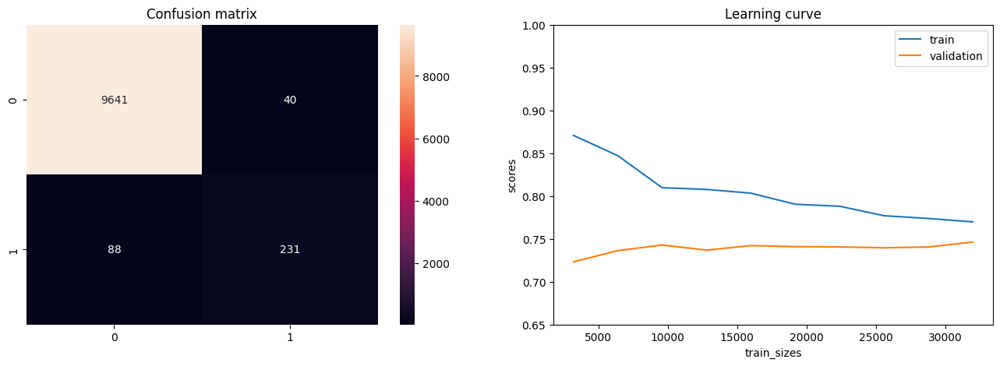

In [32]:
xgb_model = XGBClassifier(random_state=0)

#fit model to train set
xgb_model.fit(X_train, y_train)

# Define hyperparameters
params : {
        "xgbclassifier__max_depth": [4, 6, 8],
        "xgbclassifier__min_child_weight": [1, 2, 3, 4],
        "xgbclassifier__n_estimators": [25, 50, 100],
        "xgbclassifier__max_delta_step" : [0, 1, 3, 5]
    }

# fit gridsearch
grid_xgb = GridSearchCV(xgb_model, params, cv=5, scoring='f1', n_jobs=-1)
grid_xgb.fit(X_train, y_train)

# apply on test set
y_pred = grid_xgb.predict(X_test)
print(f"Best parameters :{grid_xgb.best_params_}")
print(f"Score on train set: {grid_xgb.score(X_train, y_train)} | Score on test set: {grid_xgb.score(X_test, y_test)}")
print("\n")
print(classification_report(y_test, y_pred))
    
# set model learning curve parameters
N, train_score, val_score = learning_curve(grid_xgb.best_estimator_, X_train, y_train, cv=5, scoring="f1", 
                                            train_sizes=np.linspace(0.1, 1, 10))
    
    # plot confusion matrix and learning curve
fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=False, sharex=False)
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", ax=axes[0])
axes[0].set_title("Confusion matrix")
axes[1].plot(N, train_score.mean(axis=1))
axes[1].plot(N, val_score.mean(axis=1))
axes[1].set_title("Learning curve")
axes[1].set_xlabel('train_sizes')
axes[1].set_ylabel('scores')
axes[1].set_ylim(0.65, 1.0)
axes[1].legend(["train", "validation"])
plt.show()

If we look at the classification report and the f1-score for the "1", we see that these models are really better. The Logistic Regression have a 0.80 score on predicting conversion, PolynomialFeatures seems to work well.

In [33]:
# Three best models
log_modelopt = grid_log.best_estimator_
ada_modelopt = grid_ada.best_estimator_
xgb_modelopt = grid_xgb.best_estimator_

Score on train set: 0.764629388816645 | Score on test set: 0.7905405405405406


              precision    recall  f1-score   support

           0       0.99      1.00      0.99      9681
           1       0.86      0.73      0.79       319

    accuracy                           0.99     10000
   macro avg       0.92      0.86      0.89     10000
weighted avg       0.99      0.99      0.99     10000



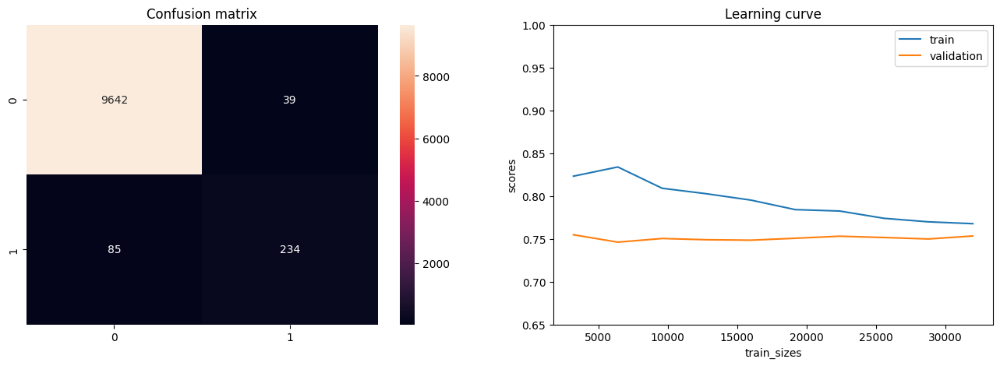

In [34]:
from sklearn.ensemble import VotingClassifier

vote_model = VotingClassifier(estimators=[("logistic", log_modelopt), ("xgb", xgb_modelopt), ("ada", ada_modelopt)], voting='soft')
vote_model.fit(X_train, y_train)

y_train_pred = vote_model.predict(X_train)
    
#apply model on test set
y_pred = vote_model.predict(X_test)
print(f"Score on train set: {f1_score(y_train, y_train_pred)} | Score on test set: {f1_score(y_test, y_pred)}")
print("\n")
print(classification_report(y_test, y_pred))
    
# set model learning curve parameters
N, train_score, val_score = learning_curve(vote_model, X_train, y_train, cv=5, scoring="f1", 
                                            train_sizes=np.linspace(0.1, 1, 10))
    
# plot confusion matrix and learning curve
fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=False, sharex=False)
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", ax=axes[0])
axes[0].set_title("Confusion matrix")
axes[1].plot(N, train_score.mean(axis=1))
axes[1].plot(N, val_score.mean(axis=1))
axes[1].set_title("Learning curve")
axes[1].set_xlabel('train_sizes')
axes[1].set_ylabel('scores')
axes[1].set_ylim(0.65, 1.0)
axes[1].legend(["train", "validation"])
plt.show()

## Best classifier on all data and predictions on X_without_labels

In [37]:
# Concatenate train and test set to train the best classifiers on all data with labels
X = np.append(X_train,X_test,axis=0)
Y = np.append(y_train,y_test)

vote_model.fit(X,Y)
# Predictions on full set
pred = vote_model.predict(X)
print("f1-score on full set : ", f1_score(Y, pred))

f1-score on full set :  0.7676837725381415


In [38]:
# Read data without labels
data_without_labels = pd.read_csv('data/conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)

features_list = ['total_pages_visited', 'new_user','age','source','country']
X_without_labels = data_without_labels.loc[:, features_list]
print(data_without_labels.head())
# same preprocessing on X_without_labels
X_without_labels = preprocessor.transform(X_without_labels)

Prediction set (without labels) : (31620, 5)
  country  age  new_user  source  total_pages_visited
0      UK   28         0     Seo                   16
1      UK   22         1  Direct                    5
2   China   32         1     Seo                    1
3      US   32         1     Ads                    6
4   China   25         0     Seo                    3


In [40]:
# Make predictions and dump to file according to challenge requirements

data = {
    'converted': vote_model.predict(X_without_labels)
}

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv('conversion_data_test_predictions_cheyen_voting.csv', index=False)